   TARGET_BAD_FLAG  TARGET_LOSS_AMT  LOAN  MORTDUE     VALUE   REASON     JOB  \
0  1                641.0            1100  25860.0  39025.0   HomeImp  Other    
1  1                1109.0           1300  70053.0  68400.0   HomeImp  Other    
2  1                767.0            1500  13500.0  16700.0   HomeImp  Other    
3  1                1425.0           1500 NaN      NaN        NaN      NaN      
4  0               NaN               1700  97800.0  112000.0  HomeImp  Office   

    YOJ  DEROG  DELINQ       CLAGE  NINQ  CLNO  DEBTINC  
0  10.5  0.0    0.0     94.366667   1.0   9.0  NaN       
1  7.0   0.0    2.0     121.833333  0.0   14.0 NaN       
2  4.0   0.0    0.0     149.466667  1.0   10.0 NaN       
3 NaN   NaN    NaN     NaN         NaN   NaN   NaN       
4  3.0   0.0    0.0     93.333333   0.0   14.0 NaN       
                         0           1           2       3          4
TARGET_BAD_FLAG  1          1           1           1       0        
TARGET_LOSS_AMT  641.0   

/var/folders/f2/qszbjcs964d9z5ywyc7cwpj80000gn/T/ipykernel_2467/2824416783.py:16: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


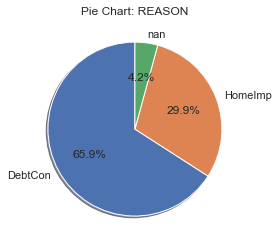

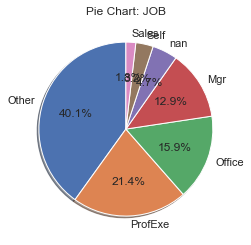

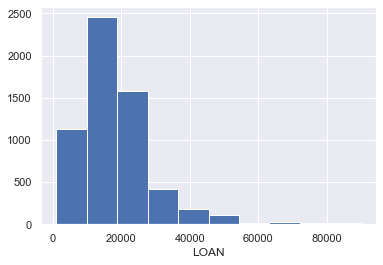

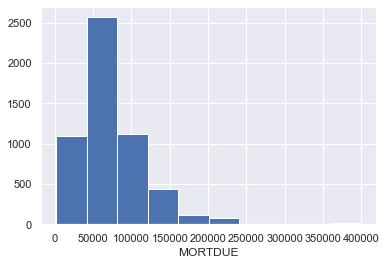

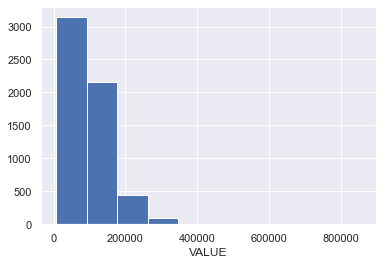

...

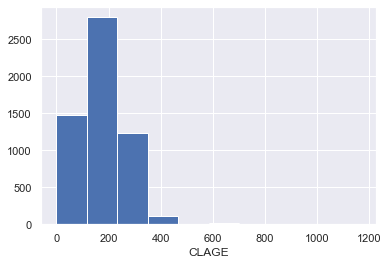

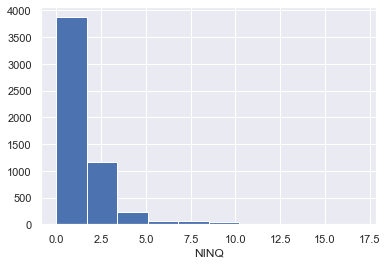

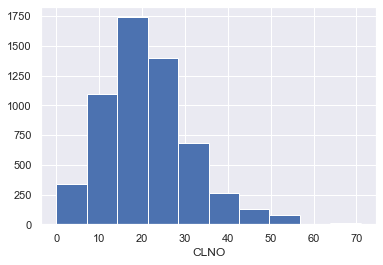

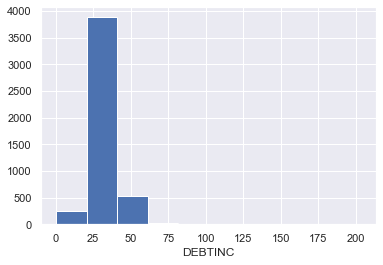

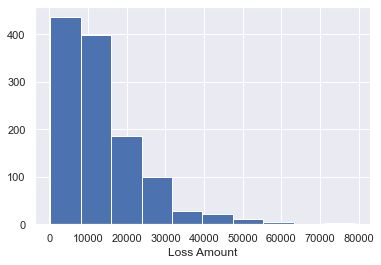

In [1]:
# Exploratory Data Analysis

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()




pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)




INFILE = "~/Desktop/Edwin/Academic/Summer2022/MSDS422/Programming/A1/HMEQ_Loss.csv"

TARGET_F = "TARGET_BAD_FLAG"
TARGET_A = "TARGET_LOSS_AMT"

df = pd.read_csv( INFILE )
'''
Print a transpose of the data so that it will fit on the screen
'''
print( df.head() )
print( df.head().T )





'''
Statistical description of data transposed so that it fits on the screen.
'''
print( df.describe() )
print( df.describe().T )
x = df.describe().T
print( x )




'''
Find the variables that are objects (strings), integers, and floats. Put their in a list.
'''

#print( df.dtypes )
dt = df.dtypes
print( dt )


objList = []
intList = []
floatList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )
    if dt[i] in (["float64"]) : floatList.append( i )
    if dt[i] in (["int64"]) : intList.append( i )

print(" OBJECTS ")
print(" ------- ")
for i in objList :
    print(i)

print(" INTEGER ")
print(" ------- ")
for i in intList :
    print(i)

print(" FLOAT ")
print(" ----- ")
for i in floatList :
    print(i)



'''
EXPLORE THE CATEGORICAL / OBJECT VARIABLES
'''


for i in objList :
    print(" Class = ", i )
    g = df.groupby( i )
    print( g[i].count() )
    x = g[ TARGET_F ].mean()
    print( "Bad Flag", x )
    print( " ................. ")
    x = g[ TARGET_A ].mean()
    print( "Loss Amount", x )
    print(" ===============\n\n\n ")




'''
PIE CHARTS
'''

for i in objList :
    x = df[ i ].value_counts(dropna=False)
   #print( x )
    theLabels = x.axes[0].tolist()
   #print( theLabels )
    theSlices = list(x)
   #print( theSlices ) 
    plt.pie( theSlices,
            labels=theLabels,
            startangle = 90,
            shadow=True,
            autopct="%1.1f%%")
    plt.title("Pie Chart: " + i)
    plt.show()


# x = df["DEROG"].value_counts(dropna=False)
# theLabels = x.axes[0].tolist()
# theSlices = list(x)
# explodeList = [ 0 for i in theSlices ]
# explodeList[2] = 0.3
# plt.pie( theSlices,
#         labels=theLabels,
#         startangle = 90,
#         explode=explodeList,
#         shadow=True,
#         autopct="%1.1f%%")
# plt.title("Pie Chart: " + i)
# plt.show()



for i in intList :
    plt.hist( df[ i ] )
    plt.xlabel( i )
    plt.show()

for i in floatList :
    plt.hist( df[ i ] )
    plt.xlabel( i )
    plt.show()
    
plt.hist( df[ TARGET_A ] )
plt.xlabel( "Loss Amount" )
plt.show()

In [2]:
# Missing Value Imputation For Class Variables

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()




pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)




INFILE = "~/Desktop/Edwin/Academic/Summer2022/MSDS422/Programming/A1/HMEQ_Loss.csv"

TARGET_F = "TARGET_BAD_FLAG"
TARGET_A = "TARGET_LOSS_AMT"

df = pd.read_csv( INFILE )


dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )


print(" OBJECTS ")
print(" ------- ")
for i in objList :
   print( i )
print(" ------- ")


for i in objList :
   print( i )
   print( df[i].unique() )
   g = df.groupby( i )
   print( g[i].count() )
   print( "MOST COMMON = ", df[i].mode()[0] )   
   print( "MISSING = ", df[i].isna().sum() )
   print( "\n\n")



"""
FILL IN MISSING WITH THE MODE
"""
for i in objList :
    if df[i].isna().sum() == 0 : continue
    print( i ) 
    print("HAS MISSING")
    NAME = "IMP_"+i
    print( NAME ) 
    df[NAME] = df[i]
    df[NAME] = df[NAME].fillna(df[NAME].mode()[0] )
    print( "variable",i," has this many missing", df[i].isna().sum() )
    print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
    g = df.groupby( NAME )
    print( g[NAME].count() )
    print( "\n\n")
    df = df.drop( i, axis=1 )



"""
FILL IN MISSING WITH THE CATEGORY "MISSING"
"""
# for i in objList :
#     if df[i].isna().sum() == 0 : continue
#     print( i ) 
#     print("HAS MISSING")
#     NAME = "IMP_"+i
#     print( NAME ) 
#     df[NAME] = df[i]
#     df[NAME] = df[NAME].fillna("MISSING")
#     print( "variable",i," has this many missing", df[i].isna().sum() )
#     print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
#     g = df.groupby( NAME )
#     print( g[NAME].count() )
#     print( "\n\n")
#     df = df.drop( i, axis=1 )


# dt = df.dtypes
# objList = []
# for i in dt.index :
#     #print(" here is i .....", i , " ..... and here is the type", dt[i] )
#     if i in ( [ TARGET_F, TARGET_A ] ) : continue
#     if dt[i] in (["object"]) : objList.append( i )

# ##print(" OBJECTS ")
# ##print(" ------- ")
# ##for i in objList :
# ##    print( i )
# ##print(" ------- ")


# for i in objList :
#     print(" Class = ", i )
#     print( df[i].unique() )
##    g = df.groupby( i )
##    x = g[ TARGET_F ].mean()
##    print( "Crash Prob", x )
##    print( " ................. ")
##    x = g[ TARGET_A ].mean()
##    #x = g[ TARGET_A ].median()
##    print( "Damage Amount", x )
##    print(" ===============\n\n\n ")


'''
EXPLORE THE CATEGORICAL / OBJECT VARIABLES
'''



#print( df["EDUCATION"].unique() )
#print( df.EDUCATION.unique() )


# df["y_EDU_4"] = (df.EDUCATION.isin( ["a_PhD"] ) + 0 )
# df["y_EDU_3"] = (df.EDUCATION.isin( ["a_PhD","b_Masters"] ) + 0)
# df["y_EDU_2"] = (df.EDUCATION.isin( ["a_PhD","b_Masters","c_Bachelors"] ) + 0)
# df["y_EDU_1"] = (df.EDUCATION.isin( ["a_PhD","b_Masters","c_Bachelors","d_High School"] ) + 0)
# df = df.drop( "EDUCATION", axis=1 )
##print( df.head().T )


##for i in ["y_EDU_4","y_EDU_3","y_EDU_2","y_EDU_1"] :
##    print(" Class = ", i )
##    g = df.groupby( i )
##    x = g[ TARGET_F ].mean()
##    print( "Crash Prob", x )
##    print( " ................. ")
##    x = g[ TARGET_A ].mean()
##    #x = g[ TARGET_A ].median()
##    print( "Damage Amount", x )
##    print(" ===============\n\n\n ")


    

dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )

##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")



for i in objList :
    #print(" Class = ", i )
    thePrefix = "z_" + i
    #print( thePrefix )
    y = pd.get_dummies( df[i], prefix=thePrefix, dummy_na=False )   
    #print( type(y) )
    #print( y.head().T )
    df = pd.concat( [df, y], axis=1 )
    df = df.drop( i, axis=1 )
    print( df.head().T )

 OBJECTS 
 ------- 
REASON
JOB
 ------- 
REASON
['HomeImp' nan 'DebtCon']
REASON
DebtCon    3928
HomeImp    1780
Name: REASON, dtype: int64
MOST COMMON =  DebtCon
MISSING =  252



JOB
['Other' nan 'Office' 'Sales' 'Mgr' 'ProfExe' 'Self']
JOB
Mgr        767 
Office     948 
Other      2388
ProfExe    1276
Sales      109 
Self       193 
Name: JOB, dtype: int64
MOST COMMON =  Other
MISSING =  279



REASON
HAS MISSING
IMP_REASON
variable REASON  has this many missing 252
variable IMP_REASON  has this many missing 0
IMP_REASON
DebtCon    4180
HomeImp    1780
Name: IMP_REASON, dtype: int64



JOB
HAS MISSING
IMP_JOB
variable JOB  has this many missing 279
variable IMP_JOB  has this many missing 0
IMP_JOB
Mgr        767 
Office     948 
Other      2667
ProfExe    1276
Sales      109 
Self       193 
Name: IMP_JOB, dtype: int64



                              0           1           2       3          4
TARGET_BAD_FLAG       1          1           1           1       0        
TARGET_LOSS_

/var/folders/f2/qszbjcs964d9z5ywyc7cwpj80000gn/T/ipykernel_2467/2832061800.py:16: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [3]:
# One Hot Encoding of Class Variables
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()




pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)





INFILE = "~/Desktop/Edwin/Academic/Summer2022/MSDS422/Programming/A1/HMEQ_Loss.csv"

TARGET_F = "TARGET_BAD_FLAG"
TARGET_A = "TARGET_LOSS_AMT"


df = pd.read_csv( INFILE )


dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )


##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")


##for i in objList :
##    print( i )
##    print( df[i].unique() )
##    g = df.groupby( i )
##    print( g[i].count() )
##    print( "MOST COMMON = ", df[i].mode()[0] )   
##    print( "MISSING = ", df[i].isna().sum() )
##    print( "\n\n")



"""
FILL IN MISSING WITH THE MODE
"""
##for i in objList :
##    if df[i].isna().sum() == 0 : continue
##    print( i ) 
##    print("HAS MISSING")
##    NAME = "IMP_"+i
##    print( NAME ) 
##    df[NAME] = df[i]
##    df[NAME] = df[NAME].fillna(df[NAME].mode()[0] )
##    print( "variable",i," has this many missing", df[i].isna().sum() )
##    print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
##    g = df.groupby( NAME )
##    print( g[NAME].count() )
##    print( "\n\n")
##    df = df.drop( i, axis=1 )



"""
FILL IN MISSING WITH THE CATEGORY "MISSING"
"""
for i in objList :
    if df[i].isna().sum() == 0 : continue
    print( i ) 
    print("HAS MISSING")
    NAME = "IMP_"+i
    print( NAME ) 
    df[NAME] = df[i]
    df[NAME] = df[NAME].fillna("MISSING")
    print( "variable",i," has this many missing", df[i].isna().sum() )
    print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
    g = df.groupby( NAME )
    print( g[NAME].count() )
    print( "\n\n")
    df = df.drop( i, axis=1 )


dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )

##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")


for i in objList :
    print(" Class = ", i )
    print( df[i].unique() )
    g = df.groupby( i )
    x = g[ TARGET_F ].mean()
    print( "Var Prob", x )
    print( " ................. ")
    x = g[ TARGET_A ].mean()
   #x = g[ TARGET_A ].median()
    print( "LOSS Amount", x )
    print(" ===============\n\n\n ")


'''
EXPLORE THE CATEGORICAL / OBJECT VARIABLES
'''





    
dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )

##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")



for i in objList :
    #print(" Class = ", i )
    thePrefix = "z_" + i
    #print( thePrefix )
    y = pd.get_dummies( df[i], prefix=thePrefix, dummy_na=False )   
    #print( type(y) )
    #print( y.head().T )
    df = pd.concat( [df, y], axis=1 )
    df = df.drop( i, axis=1 )
    print( df.head().T )



REASON
HAS MISSING
IMP_REASON
variable REASON  has this many missing 252
variable IMP_REASON  has this many missing 0
IMP_REASON
DebtCon    3928
HomeImp    1780
MISSING    252 
Name: IMP_REASON, dtype: int64



JOB
HAS MISSING
IMP_JOB
variable JOB  has this many missing 279
variable IMP_JOB  has this many missing 0
IMP_JOB
MISSING    279 
Mgr        767 
Office     948 
Other      2388
ProfExe    1276
Sales      109 
Self       193 
Name: IMP_JOB, dtype: int64



 Class =  IMP_REASON
['HomeImp' 'MISSING' 'DebtCon']
Var Prob IMP_REASON
DebtCon    0.189664
HomeImp    0.222472
MISSING    0.190476
Name: TARGET_BAD_FLAG, dtype: float64
 ................. 
LOSS Amount IMP_REASON
DebtCon    16005.163758
HomeImp    8388.090909 
MISSING    14675.020833
Name: TARGET_LOSS_AMT, dtype: float64


 
 Class =  IMP_JOB
['Other' 'MISSING' 'Office' 'Sales' 'Mgr' 'ProfExe' 'Self']
Var Prob IMP_JOB
MISSING    0.082437
Mgr        0.233377
Office     0.131857
Other      0.231993
ProfExe    0.166144
Sales    

/var/folders/f2/qszbjcs964d9z5ywyc7cwpj80000gn/T/ipykernel_2467/3861696385.py:15: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [4]:
df

,TARGET_BAD_FLAG,TARGET_LOSS_AMT,LOAN,MORTDUE,VALUE,YOJ,DEROG,DELINQ,CLAGE,NINQ,CLNO,DEBTINC,z_IMP_REASON_DebtCon,z_IMP_REASON_HomeImp,z_IMP_REASON_MISSING,z_IMP_JOB_MISSING,z_IMP_JOB_Mgr,z_IMP_JOB_Office,z_IMP_JOB_Other,z_IMP_JOB_ProfExe,z_IMP_JOB_Sales,z_IMP_JOB_Self
0,1,641.0,1100,25860.00,39025.00,10.50,0.0,0.0,94.366667,1.0,9.0,NaN,0,1,0,0,0,0,1,0,0,0
1,1,1109.0,1300,70053.00,68400.00,7.00,0.0,2.0,121.833333,0.0,14.0,NaN,0,1,0,0,0,0,1,0,0,0
2,1,767.0,1500,13500.00,16700.00,4.00,0.0,0.0,149.466667,1.0,10.0,NaN,0,1,0,0,0,0,1,0,0,0
3,1,1425.0,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,1,1,0,0,0,0,0,0
4,0,NaN,1700,97800.00,112000.00,3.00,0.0,0.0,93.333333,0.0,14.0,NaN,0,1,0,0,0,1,0,0,0,0
5,1,335.0,1700,30548.00,40320.00,9.00,0.0,0.0,101.466002,1.0,8.0,37.113614,0,1,0,0,0,0,1,0,0,0
6,1,1841.0,1800,48649.00,57037.00,5.00,3.0,2.0,77.100000,1.0,17.0,NaN,0,1,0,0,0,0,1,0,0,0
7,1,373.0,1800,28502.00,43034.00,11.00,0.0,0.0,88.766030,0.0,8.0,36.884894,0,1,0,0,0,0,1,0,0,0
8,1,1217.0,2000,32700.00,46740.00,3.00,0.0,2.0,216.933333,1.0,12.0,NaN,0,1,0,0,0,0,1,0,0,0
9,1,1523.0,2000,NaN,62250.00,16.00,0.0,0.0,115.800000,0.0,13.0,NaN,0,1,0,0,0,0,0,0,1,0


In [5]:
# Missing Value Imputation For Numeric Variables

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()




pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)



df = pd.read_csv('HMEQ_Loss.csv')
dt = df.dtypes

TARGET_F = "TARGET_BAD_FLAG"
TARGET_A = "TARGET_LOSS_AMT"


#print( dt )

objList = []
numList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )
    if dt[i] in (["float64","int64"]) : numList.append( i )


print(" OBJECTS ")
print(" ------- ")
for i in objList :
    print( i )
print(" ------- ")


print(" NUMBER ")
print(" ------- ")
for i in numList :
    print( i )
print(" ------- ")







"""
FILL IN MISSING WITH THE CATEGORY "MISSING"
"""
#How many objects are in the list
for i in objList :
    if df[i].isna().sum() == 0 : continue
    NAME = "IMP_"+i
    df[NAME] = df[i]
    df[NAME] = df[NAME].fillna("MISSING")
    g = df.groupby( NAME )
    df = df.drop( i, axis=1 )


dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )



'''
EXPLORE THE CATEGORICAL / OBJECT VARIABLES
'''

# df["y_JOB_7"] = (df.IMP_JOB.isin( ["a_Other"] ) + 0 )
# df["y_JOB_6"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING"] ) + 0)
# df["y_JOB_5"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office"] ) + 0)
# df["y_JOB_4"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales"] ) + 0)
# df["y_JOB_3"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr"] ) + 0)
# df["y_JOB_2"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr","f_ProfExe"] ) + 0)
# df["y_JOB_1"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr","f_ProfExe","g_Self"] ) + 0)
# df = df.drop( "IMP_JOB", axis=1 )
 

dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )


for i in objList :
    thePrefix = "z_" + i
    y = pd.get_dummies( df[i], prefix=thePrefix, drop_first=True )   
    #y = pd.get_dummies( df[i], prefix=thePrefix )   
    df = pd.concat( [df, y], axis=1 )
    #df = df.drop( i, axis=1 )



g = df.groupby("IMP_JOB")
i = "VALUE"
print( g[i].median() )

i = "VALUE"
FLAG = "M_" + i
IMP = "IMP_" + i
#print( i )
#print( FLAG )
#print( IMP )
df[ FLAG ] = df[i].isna() + 0
df[ IMP ] = df[ i ]
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["Mgr"]), IMP ] = 767
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["Office"]), IMP ] = 948
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["Other"]), IMP ] = 2388
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["Doctor"]), IMP ] = 1276
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["ProfExe"]), IMP ] = 109
df.loc[ df[IMP].isna() & df["IMP_JOB"].isin(["Sales"]), IMP ] = 193
df.loc[ df[IMP].isna(), IMP ] = df[i].median()
df = df.drop( i, axis=1 )
numList.remove(i)


for i in numList :
    if df[i].isna().sum() == 0 : continue
    FLAG = "M_" + i
    IMP = "IMP_" + i
    #print(i)
    #print( df[i].isna().sum() )
    #print( FLAG )
    #print( IMP )
    #print(" ------- ")
    df[ FLAG ] = df[i].isna() + 0
    df[ IMP ] = df[ i ]
    df.loc[ df[IMP].isna(), IMP ] = df[i].median()
    df = df.drop( i, axis=1 )



for i in objList:
    df = df.drop( i, axis=1 )




SomeData = df.head().T
for r in range( SomeData.shape[0] ):
    print( SomeData.iloc[r,] )
    print("---\n\n")

 OBJECTS 
 ------- 
REASON
JOB
 ------- 
 NUMBER 
 ------- 
LOAN
MORTDUE
VALUE
YOJ
DEROG
DELINQ
CLAGE
NINQ
CLNO
DEBTINC
 ------- 
IMP_JOB
MISSING     78227.0
Mgr        101258.0
Office      89094.5
Other       76599.5
ProfExe    110007.0
Sales       84473.5
Self       130631.0
Name: VALUE, dtype: float64
0    1.0
1    1.0
2    1.0
3    1.0
4    0.0
Name: TARGET_BAD_FLAG, dtype: float64
---


0     641.0
1    1109.0
2     767.0
3    1425.0
4       NaN
Name: TARGET_LOSS_AMT, dtype: float64
---


0    1100.0
1    1300.0
2    1500.0
3    1500.0
4    1700.0
Name: LOAN, dtype: float64
---


0    1.0
1    1.0
2    1.0
3    0.0
4    1.0
Name: z_IMP_REASON_HomeImp, dtype: float64
---


0    0.0
1    0.0
2    0.0
3    1.0
4    0.0
Name: z_IMP_REASON_MISSING, dtype: float64
---


0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: z_IMP_JOB_Mgr, dtype: float64
---


0    0.0
1    0.0
2    0.0
3    0.0
4    1.0
Name: z_IMP_JOB_Office, dtype: float64
---


0    1.0
1    1.0
2    1.0
3    0.0
4    0.

In [6]:
df

,TARGET_BAD_FLAG,TARGET_LOSS_AMT,LOAN,z_IMP_REASON_HomeImp,z_IMP_REASON_MISSING,z_IMP_JOB_Mgr,z_IMP_JOB_Office,z_IMP_JOB_Other,z_IMP_JOB_ProfExe,z_IMP_JOB_Sales,z_IMP_JOB_Self,M_VALUE,IMP_VALUE,M_MORTDUE,IMP_MORTDUE,M_YOJ,IMP_YOJ,M_DEROG,IMP_DEROG,M_DELINQ,IMP_DELINQ,M_CLAGE,IMP_CLAGE,M_NINQ,IMP_NINQ,M_CLNO,IMP_CLNO,M_DEBTINC,IMP_DEBTINC
0,1,641.0,1100,1,0,0,0,1,0,0,0,0,39025.00,0,25860.00,0,10.50,0,0.0,0,0.0,0,94.366667,0,1.0,0,9.0,1,34.818262
1,1,1109.0,1300,1,0,0,0,1,0,0,0,0,68400.00,0,70053.00,0,7.00,0,0.0,0,2.0,0,121.833333,0,0.0,0,14.0,1,34.818262
2,1,767.0,1500,1,0,0,0,1,0,0,0,0,16700.00,0,13500.00,0,4.00,0,0.0,0,0.0,0,149.466667,0,1.0,0,10.0,1,34.818262
3,1,1425.0,1500,0,1,0,0,0,0,0,0,1,89235.50,1,65019.00,1,7.00,1,0.0,1,0.0,1,173.466667,1,1.0,1,20.0,1,34.818262
4,0,NaN,1700,1,0,0,1,0,0,0,0,0,112000.00,0,97800.00,0,3.00,0,0.0,0,0.0,0,93.333333,0,0.0,0,14.0,1,34.818262
5,1,335.0,1700,1,0,0,0,1,0,0,0,0,40320.00,0,30548.00,0,9.00,0,0.0,0,0.0,0,101.466002,0,1.0,0,8.0,0,37.113614
6,1,1841.0,1800,1,0,0,0,1,0,0,0,0,57037.00,0,48649.00,0,5.00,0,3.0,0,2.0,0,77.100000,0,1.0,0,17.0,1,34.818262
7,1,373.0,1800,1,0,0,0,1,0,0,0,0,43034.00,0,28502.00,0,11.00,0,0.0,0,0.0,0,88.766030,0,0.0,0,8.0,0,36.884894
8,1,1217.0,2000,1,0,0,0,1,0,0,0,0,46740.00,0,32700.00,0,3.00,0,0.0,0,2.0,0,216.933333,0,1.0,0,12.0,1,34.818262
9,1,1523.0,2000,1,0,0,0,0,0,1,0,0,62250.00,1,65019.00,0,16.00,0,0.0,0,0.0,0,115.800000,0,0.0,0,13.0,1,34.818262


In [7]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()




pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)


df = pd.read_csv('HMEQ_Loss.csv')
dt = df.dtypes

TARGET_F = "TARGET_BAD_FLAG"
TARGET_A = "TARGET_LOSS_AMT"

dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )


##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")


##for i in objList :
##    print( i )
##    print( df[i].unique() )
##    g = df.groupby( i )
##    print( g[i].count() )
##    print( "MOST COMMON = ", df[i].mode()[0] )   
##    print( "MISSING = ", df[i].isna().sum() )
##    print( "\n\n")



"""
FILL IN MISSING WITH THE MODE
"""
##for i in objList :
##    if df[i].isna().sum() == 0 : continue
##    print( i ) 
##    print("HAS MISSING")
##    NAME = "IMP_"+i
##    print( NAME ) 
##    df[NAME] = df[i]
##    df[NAME] = df[NAME].fillna(df[NAME].mode()[0] )
##    print( "variable",i," has this many missing", df[i].isna().sum() )
##    print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
##    g = df.groupby( NAME )
##    print( g[NAME].count() )
##    print( "\n\n")
##    df = df.drop( i, axis=1 )



"""
FILL IN MISSING WITH THE CATEGORY "MISSING"
"""
for i in objList :
    if df[i].isna().sum() == 0 : continue
    print( i ) 
    print("HAS MISSING")
    NAME = "IMP_"+i
    print( NAME ) 
    df[NAME] = df[i]
    df[NAME] = df[NAME].fillna("MISSING")
    print( "variable",i," has this many missing", df[i].isna().sum() )
    print( "variable",NAME," has this many missing", df[NAME].isna().sum() )
    g = df.groupby( NAME )
    print( g[NAME].count() )
    print( "\n\n")
    df = df.drop( i, axis=1 )


dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )

##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")


for i in objList :
    print(" Class = ", i )
    print( df[i].unique() )
##    g = df.groupby( i )
##    x = g[ TARGET_F ].mean()
##    print( "Crash Prob", x )
##    print( " ................. ")
##    x = g[ TARGET_A ].mean()
##    #x = g[ TARGET_A ].median()
##    print( "Damage Amount", x )
##    print(" ===============\n\n\n ")


'''
EXPLORE THE CATEGORICAL / OBJECT VARIABLES
'''



#print( df["EDUCATION"].unique() )
#print( df.EDUCATION.unique() )


df["y_JOB_7"] = (df.IMP_JOB.isin( ["a_Other"] ) + 0 )
df["y_JOB_6"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING"] ) + 0)
df["y_JOB_5"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office"] ) + 0)
df["y_JOB_4"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales"] ) + 0)
df["y_JOB_3"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr"] ) + 0)
df["y_JOB_2"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr","f_ProfExe"] ) + 0)
df["y_JOB_1"] = (df.IMP_JOB.isin( ["a_Other","b_MISSING","c_Office","d_Sales","e_Mgr","f_ProfExe","g_Self"] ) + 0)
df = df.drop( "IMP_JOB", axis=1 )
#print( df.head().T )


for i in ["y_JOB_7","y_JOB_6","y_JOB_5","y_JOB_4","y_JOB_3","y_JOB_2","y_JOB_1"] :
    print(" Class = ", i )
    g = df.groupby( i )
    x = g[ TARGET_F ].mean()
    print( "Crash Prob", x )
    print( " ................. ")
    x = g[ TARGET_A ].mean()
   #x = g[ TARGET_A ].median()
    print( "Damage Amount", x )
    print(" ===============\n\n\n ")


    

dt = df.dtypes
objList = []
for i in dt.index :
    #print(" here is i .....", i , " ..... and here is the type", dt[i] )
    if i in ( [ TARGET_F, TARGET_A ] ) : continue
    if dt[i] in (["object"]) : objList.append( i )

##print(" OBJECTS ")
##print(" ------- ")
##for i in objList :
##    print( i )
##print(" ------- ")



for i in objList :
    #print(" Class = ", i )
    thePrefix = "z_" + i
    #print( thePrefix )
    y = pd.get_dummies( df[i], prefix=thePrefix, dummy_na=False )   
    #print( type(y) )
    #print( y.head().T )
    df = pd.concat( [df, y], axis=1 )
    df = df.drop( i, axis=1 )
    #print( df.head().T )


REASON
HAS MISSING
IMP_REASON
variable REASON  has this many missing 252
variable IMP_REASON  has this many missing 0
IMP_REASON
DebtCon    3928
HomeImp    1780
MISSING     252
Name: IMP_REASON, dtype: int64



JOB
HAS MISSING
IMP_JOB
variable JOB  has this many missing 279
variable IMP_JOB  has this many missing 0
IMP_JOB
MISSING     279
Mgr         767
Office      948
Other      2388
ProfExe    1276
Sales       109
Self        193
Name: IMP_JOB, dtype: int64



 Class =  IMP_REASON
['HomeImp' 'MISSING' 'DebtCon']
 Class =  IMP_JOB
['Other' 'MISSING' 'Office' 'Sales' 'Mgr' 'ProfExe' 'Self']
 Class =  y_JOB_7
Crash Prob y_JOB_7
0    0.199497
Name: TARGET_BAD_FLAG, dtype: float64
 ................. 
Damage Amount y_JOB_7
0    13414.576955
Name: TARGET_LOSS_AMT, dtype: float64


 
 Class =  y_JOB_6
Crash Prob y_JOB_6
0    0.199497
Name: TARGET_BAD_FLAG, dtype: float64
 ................. 
Damage Amount y_JOB_6
0    13414.576955
Name: TARGET_LOSS_AMT, dtype: float64


 
 Class =  y_JOB_5
C

In [8]:
df

,TARGET_BAD_FLAG,TARGET_LOSS_AMT,LOAN,MORTDUE,VALUE,YOJ,DEROG,DELINQ,CLAGE,NINQ,CLNO,DEBTINC,y_JOB_7,y_JOB_6,y_JOB_5,y_JOB_4,y_JOB_3,y_JOB_2,y_JOB_1,z_IMP_REASON_DebtCon,z_IMP_REASON_HomeImp,z_IMP_REASON_MISSING
0,1,641.0,1100,25860.00,39025.00,10.50,0.0,0.0,94.366667,1.0,9.0,NaN,0,0,0,0,0,0,0,0,1,0
1,1,1109.0,1300,70053.00,68400.00,7.00,0.0,2.0,121.833333,0.0,14.0,NaN,0,0,0,0,0,0,0,0,1,0
2,1,767.0,1500,13500.00,16700.00,4.00,0.0,0.0,149.466667,1.0,10.0,NaN,0,0,0,0,0,0,0,0,1,0
3,1,1425.0,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,1
4,0,NaN,1700,97800.00,112000.00,3.00,0.0,0.0,93.333333,0.0,14.0,NaN,0,0,0,0,0,0,0,0,1,0
5,1,335.0,1700,30548.00,40320.00,9.00,0.0,0.0,101.466002,1.0,8.0,37.113614,0,0,0,0,0,0,0,0,1,0
6,1,1841.0,1800,48649.00,57037.00,5.00,3.0,2.0,77.100000,1.0,17.0,NaN,0,0,0,0,0,0,0,0,1,0
7,1,373.0,1800,28502.00,43034.00,11.00,0.0,0.0,88.766030,0.0,8.0,36.884894,0,0,0,0,0,0,0,0,1,0
8,1,1217.0,2000,32700.00,46740.00,3.00,0.0,2.0,216.933333,1.0,12.0,NaN,0,0,0,0,0,0,0,0,1,0
9,1,1523.0,2000,NaN,62250.00,16.00,0.0,0.0,115.800000,0.0,13.0,NaN,0,0,0,0,0,0,0,0,1,0
